**Intensity Trasformation **

  1. Linear(Identity, Negative)
  2. Logrithemic (log, invers log)
  3. power law(ntu, )

In [27]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams["figure.autolayout"] = True

In [3]:
img= cv2.imread('Fig0304(a)(breast_digital_Xray).tif')

In [4]:
def negative(r):
  s = 255-r
  return s

Text(0, 0.5, 'output intensity levels')

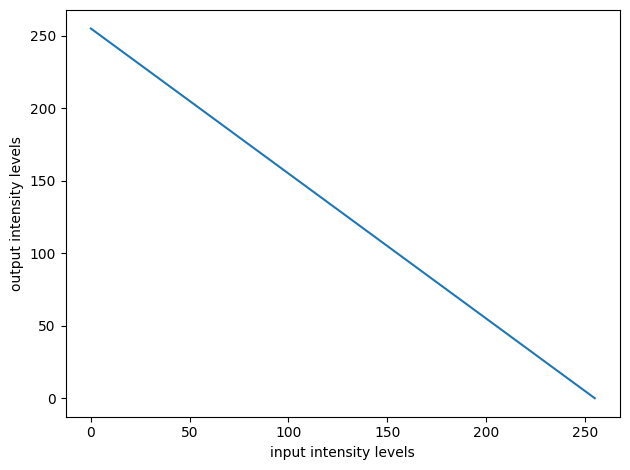

In [5]:
x_values = np.linspace(0,255,500)
y_values = negative(x_values)

plt.plot(x_values, y_values)
plt.xlabel('input intensity levels')
plt.ylabel('output intensity levels')

In [6]:
img_neg =negative(img)

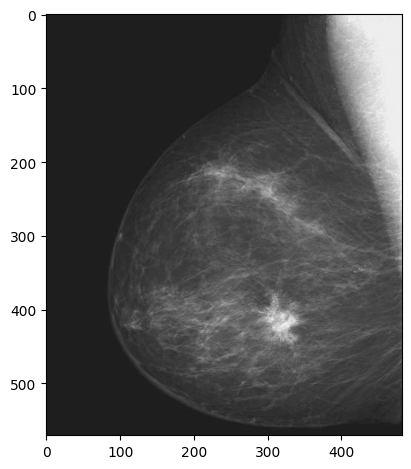

In [7]:
plt.imshow(img)

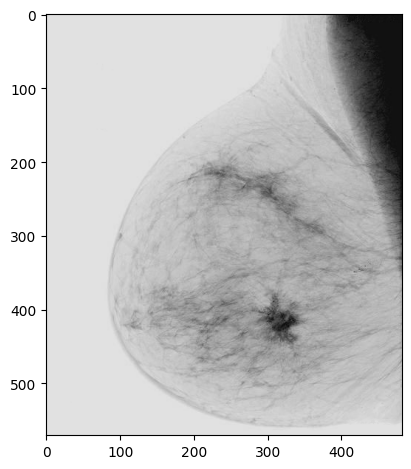

In [10]:
plt.imshow(img_neg)

In [11]:
def scale_image(imput_img):
  imput_img = imput_img/np.max(imput_img)
  input_img = (imput_img*255).astype('int')
def scale_image(imput_img):
  imput_img = imput_img/np.max(imput_img)
  input_img = (imput_img*255).astype('int')
  return input_img

def plot_results (input_img, Output_img,X_values,Y_values,save_as):

#plotting the grap
  plt.figure(figsize=(36,12))

  plt.subplot(131)
  plt.imshow(input_img)
  plt.title('Input Image')
  plt.axis('off')

  plt.subplot(132)
  plt.plot(X_values,Y_values)
  plt.xlabel('Input Pixels')
  plt.ylabel('output Pixels')
  plt.grid(True)


  plt.subplot(133)
  plt.imshow(Output_img)
  plt.title('Transformed Image')
  plt.axis('off')

  plt.savefig(save_as + '.png')

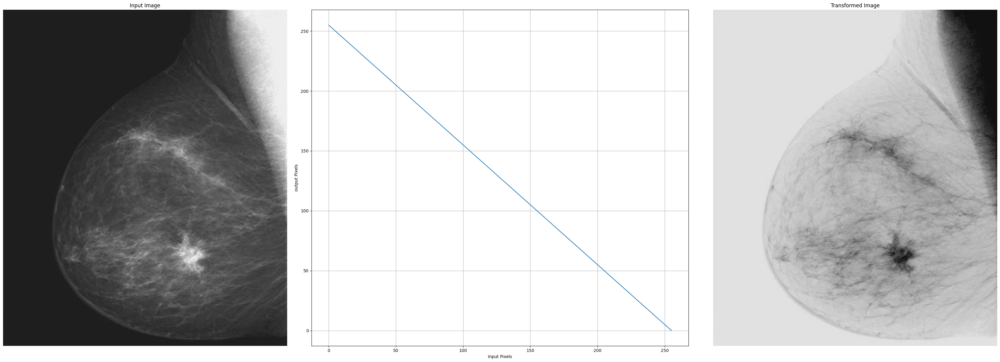

In [12]:
plot_results(img,img_neg,x_values,y_values,'negative')

# Log transformation

In [13]:
im = cv2.imread('Fig0305(a)(DFT_no_log).tif')

In [14]:
def logTransform(r,c=1):
  s=c*np.log(1.0+r)
  return s

In [15]:
img_log =logTransform(im)
img_log_scaled = scale_image(img_log)

In [16]:
x_values = np.linspace(0, 255, 500)    #oත් 255 ත් අතර පොයින්ට් 500ක් හදාගන්න ඕනී
y_values = logTransform(x_values)

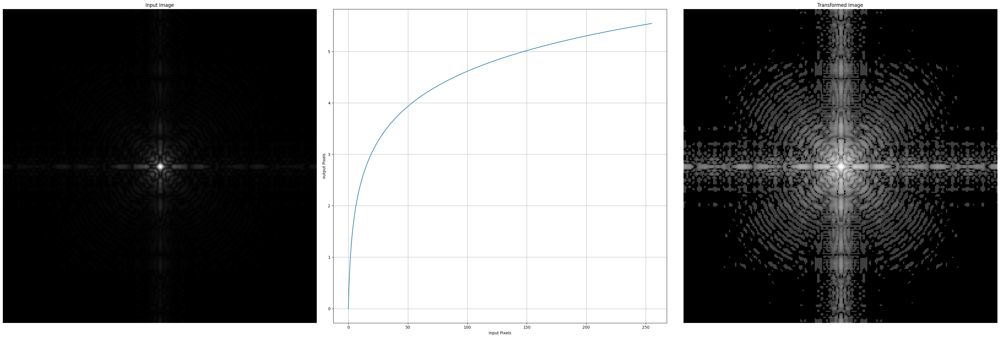

In [17]:
plot_results(im, img_log_scaled, x_values, y_values, 'log')

# Gema Transformation

2025 March 10

In [23]:
spine_img = cv2.imread('Fig0308(a)(fractured_spine).tif')

In [24]:
def gammaTransform(r, gamma, c=1):
  s=c* (r**gamma)
  return s

In [25]:
img_gamma = gammaTransform(spine_img, 0.4)
img_gamma_scaled = scale_image(img_gamma)

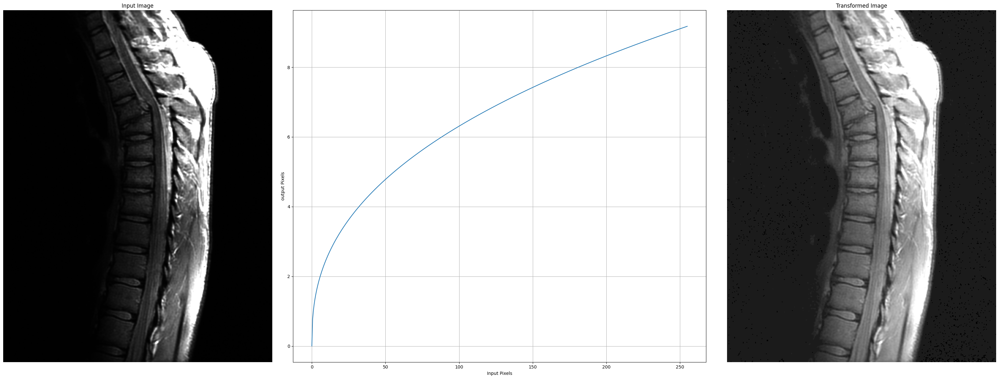

In [29]:
x_values = np.linspace(0,255,500)
y_values= gammaTransform(x_values, 0.4)
plot_results(spine_img,img_gamma_scaled,x_values,y_values,'gamma_0_4')

Gamma Transformation function

In [39]:
def performaGammaTransform(input_img,gammaValue):
  img_gamma= gammaTransform(input_img, gammaValue)
  img_gamma_scaled = scale_image(img_gamma)

  #require for plotting

  x_values =np.linspace(0,255,500)
  y_values= gammaTransform(x_values,gammaValue)
  plot_results(input_img, img_gamma_scaled, x_values, y_values, "gamma " + str(gammaValue))


  return img_gamma_scaled



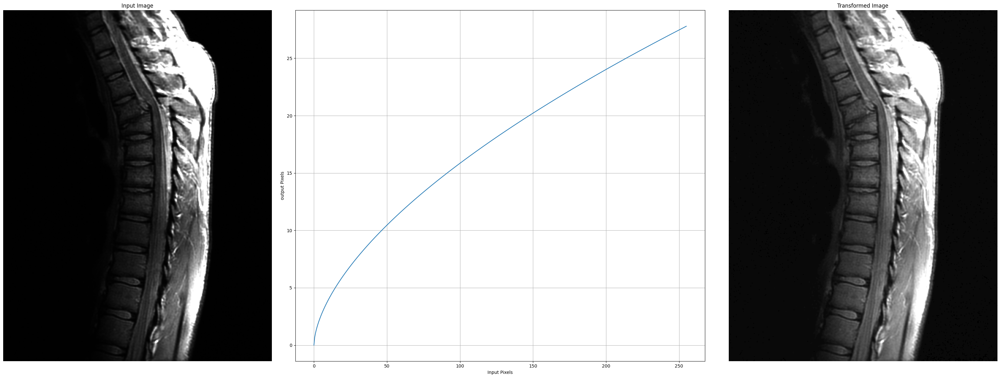

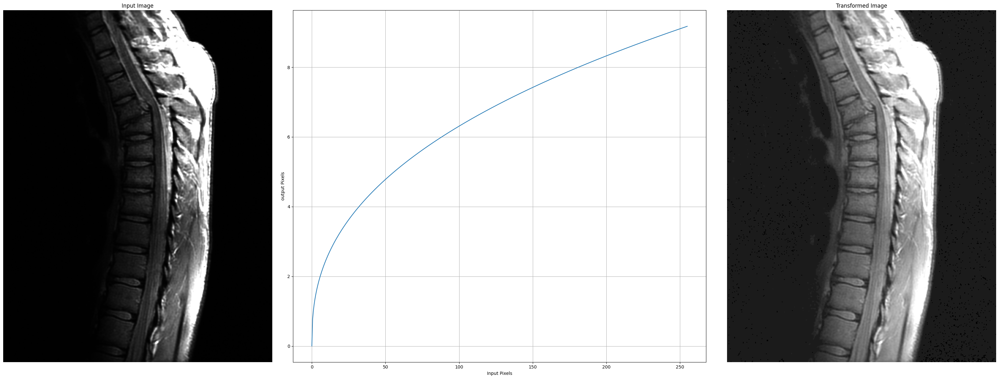

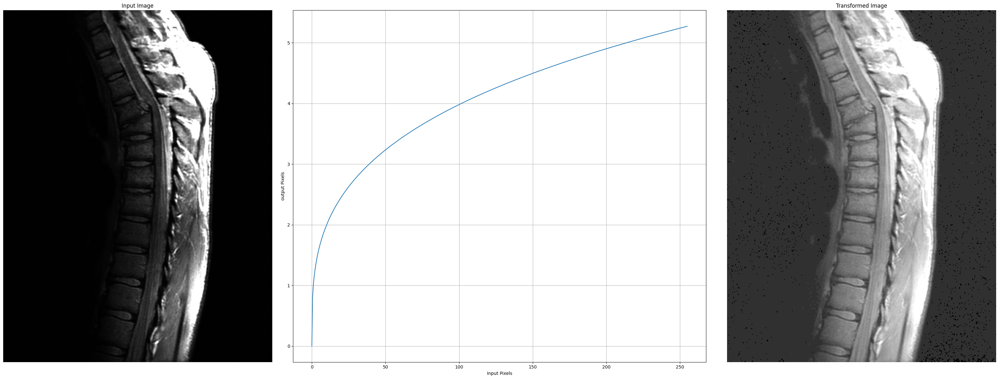

In [42]:
final_images=[]

for gammaValue in [0.6,0.4,0.3]:
  final_images.append(performaGammaTransform(spine_img,gammaValue))

with gamma > 1

In [36]:
arial_im = cv2.imread('Fig0309(a)(washed_out_aerial_image).tif')

(-0.5, 764.5, 768.5, -0.5)

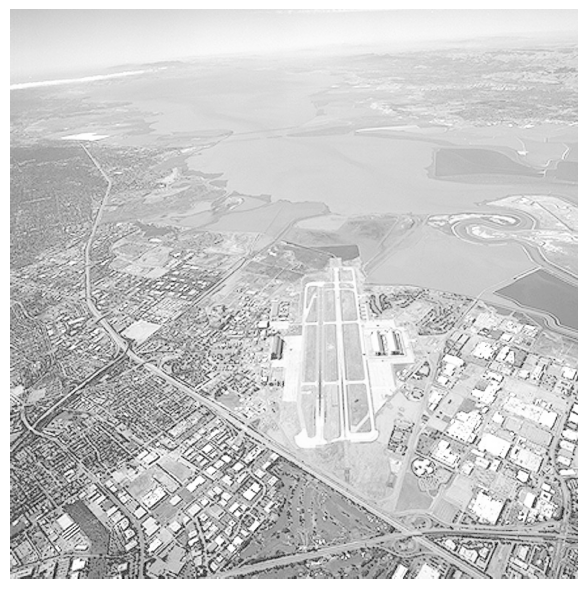

In [37]:

plt.figure(figsize=(10,6))
plt.imshow(arial_im)
plt.axis('off')

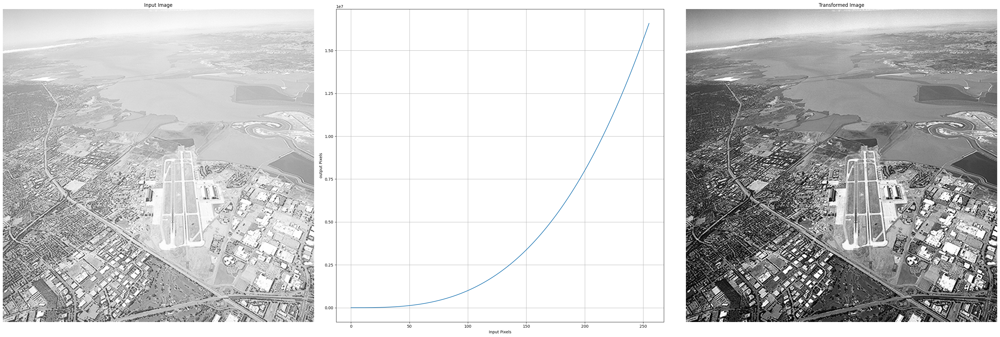

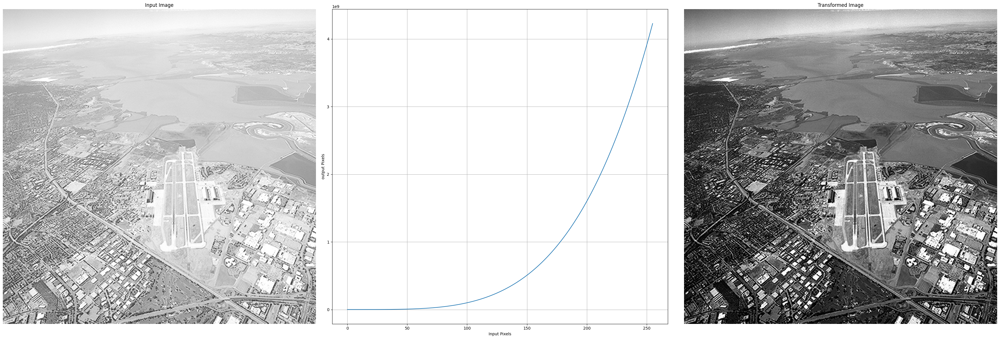

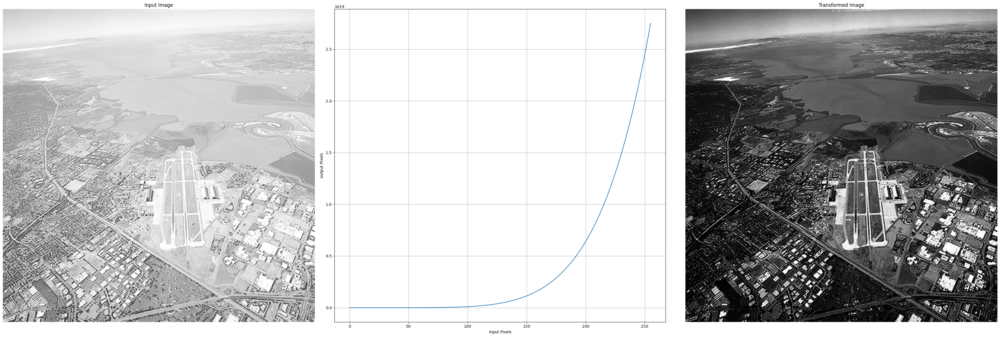

In [41]:
final_img_arial=[]
for gammaVale in [3.0,4.0,6.0]:
  final_img_arial.append(performaGammaTransform(arial_im,gammaVale))

# Contrast Streching (piecewise linear transformation)

In [43]:
im= cv2.imread('Fig0310(b)(washed_out_pollen_image).tif')


(-0.5, 888.5, 888.5, -0.5)

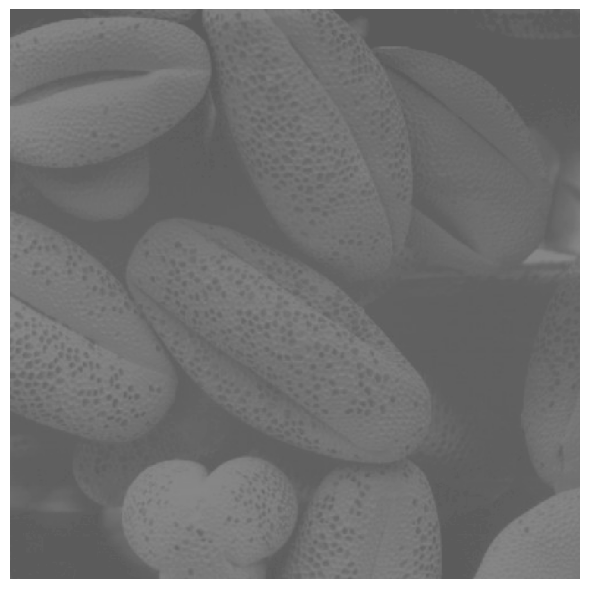

In [44]:
plt.figure(figsize=(10,6))
plt.imshow(im)
plt.axis('off')

In [46]:
# this is not the universal function for the piecewiseLinear and it is change on the image
def piecewiseLinear(r,r1,s1,r2,s2):
  if r < r1:
    s= (s1/r1)*r
  elif r > r1 and r < r2:
    s=((s2-s1)/(r2-r1)) * (r-r1)+s1
  else:
    s=((255-s2)/(255-r2)) * (r-r2)+s2

  return int(s)

In [54]:
piecewiseLinearVec = np.vectorize(piecewiseLinear)

#vectorice function done the thing without for loop and it use piecewiseLinear.it can manage multiple values. it pass the value one by one

In [56]:
x_values=np.linspace(0,255,500)
y_values=piecewiseLinearVec(x_values,80,30,150,190)

In [57]:
transfomed_im= piecewiseLinearVec(im,80,30,150,190)


#x_values= r values= input values

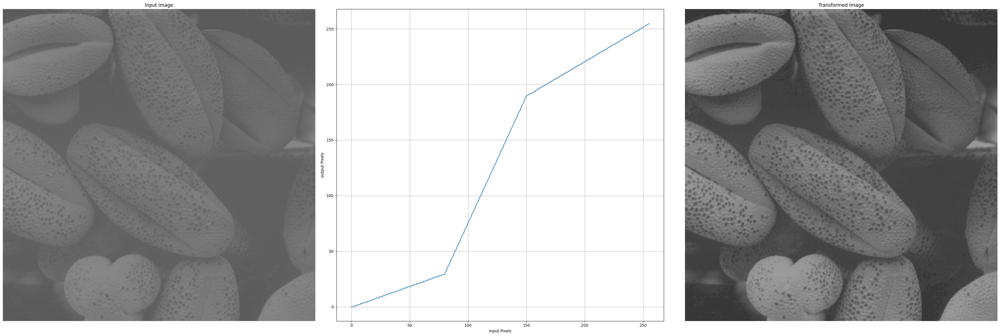

In [58]:
plot_results(im,transfomed_im,x_values,y_values,"pieswise")

using difference value for (r1,s1),(r2,s2)

In [62]:
m=np.mean(im)
transformed_im2= piecewiseLinearVec(im,m,0,m,255)

In [63]:
x_values=np.linspace(0,255,500)
y_values=piecewiseLinearVec(x_values,m,0,m,255)

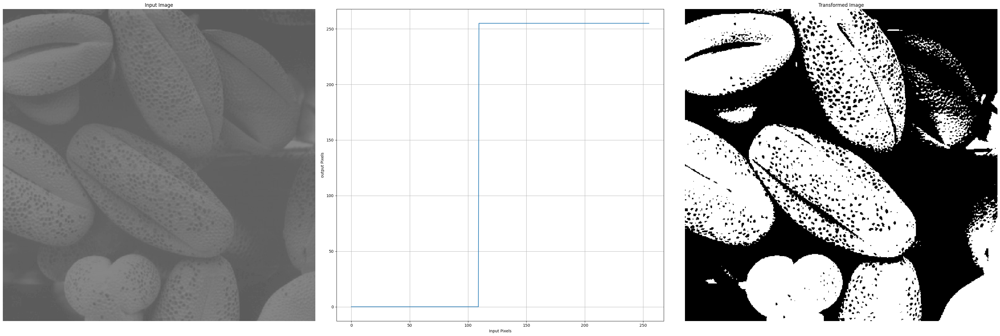

In [64]:
plot_results(im,transformed_im2, x_values,y_values,'piecewise2')

# Intensity level slicing

In [65]:
kidney_img=cv2.imread('Fig0312(a)(kidney).tif')

(-0.5, 719.5, 827.5, -0.5)

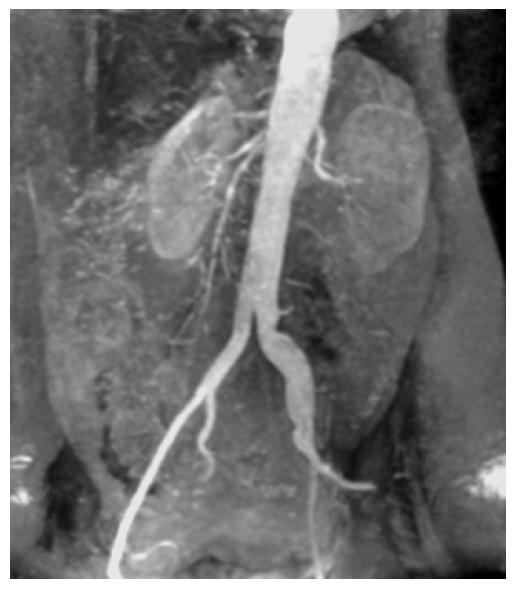

In [66]:
plt.figure(figsize=(10,6))
plt.imshow(kidney_img)
plt.axis('off')

In [67]:
def intensityLevelTrasformation(r):
  if r >140 and r<210:
    return 255
  else:
    return 0

In [72]:
intensityLevelTrasformationvac=np.vectorize(intensityLevelTrasformation)

In [ ]:
x_values=np.linspace(0,255,500)
y_values=piecewiseLinearVec(x_values)

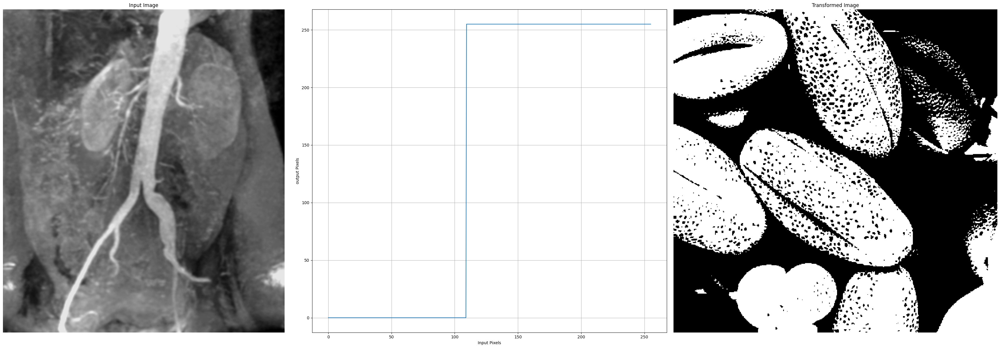

In [73]:
plot_results(kidney_img,transformed_im2, x_values,y_values,'intencityvalueSlicing')

In [74]:
def intensityLevelTrasformation2(r):
  if r >140 and r<210:
    return 240
  else:
    return r

In [77]:
intensityLevelTrasformationvac=np.vectorize(intensityLevelTrasformation2)

In [79]:
x_values=np.linspace(0,255,500)
y_values=intensityLevelTrasformationvac(x_values)

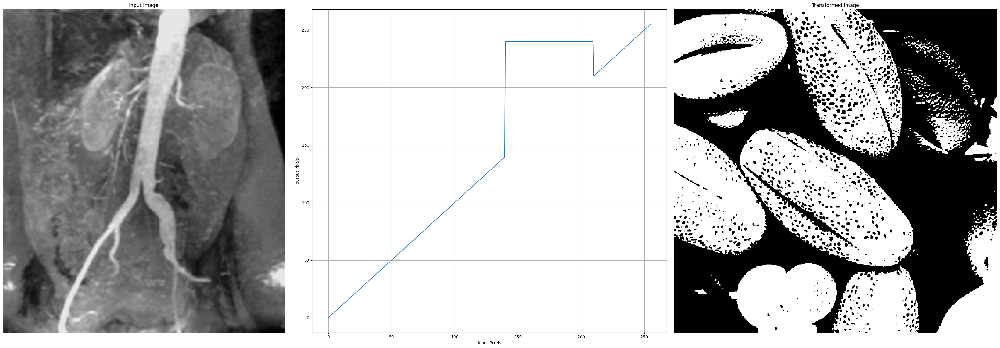

In [80]:
plot_results(kidney_img,transformed_im2, x_values,y_values,'intencityvalueSlicing')

# Bit plane Slicing

In [108]:
dollar_img= cv2.imread('Fig0314(a)(100-dollars).tif',0)

(-0.5, 1191.5, 499.5, -0.5)

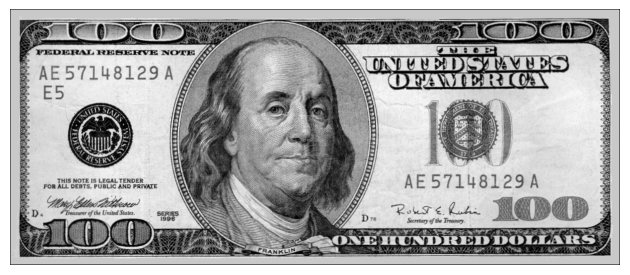

In [115]:
plt.imshow(dollar_img,cmap='gray')
plt.axis('off')

In [116]:
def bitPlaneSlicing(r,bit_plane):
  dec=np.binary_repr(r,width=8)
  return int(dec[8-bit_plane])

In [117]:
bitPlaneSlicingVec=np.vectorize(bitPlaneSlicing)

In [118]:
eight_bitplace= bitPlaneSlicingVec(dollar_img,bit_plane=8)

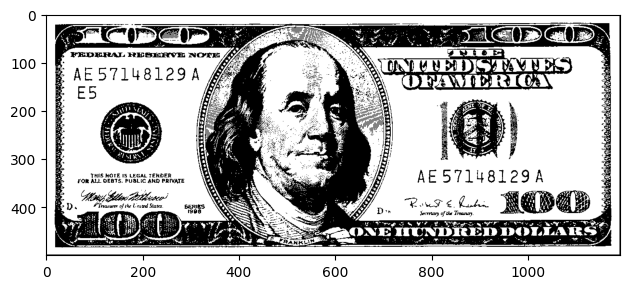

In [119]:
plt.imshow(eight_bitplace,cmap='gray')    #this is only use for the image show only